##Part1

In [ ]:
import numpy as np
from heapq import *

import PIL
from PIL import Image
import glob

In [208]:
def combineThePicturs(inputPath, outputPath):
    #here I put all the pictures in the folder into a list
    listOfPicFiles = glob.glob(inputPath) #"./shredded-images/simple_almastatue/*.png"
    listOfPicFiles.sort()
    #read them as pictures
    imgs = [ PIL.Image.open(i) for i in listOfPicFiles ]
    #find the min shape
    min_shape = sorted( [(np.sum(i.size), i.size ) for i in imgs])[0][1]
    imgs_comb = np.hstack( (np.asarray( i.resize(min_shape) ) for i in imgs ) )
    # save that result picture
    imgs_comb = PIL.Image.fromarray(imgs_comb)
    display(imgs_comb)
    imgs_comb.save( outputPath ) #  './c_simple_almastatue.png'
    


<ipython-input-208-2ffbae4f166a>:9: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  imgs_comb = np.hstack( (np.asarray( i.resize(min_shape) ) for i in imgs ) )


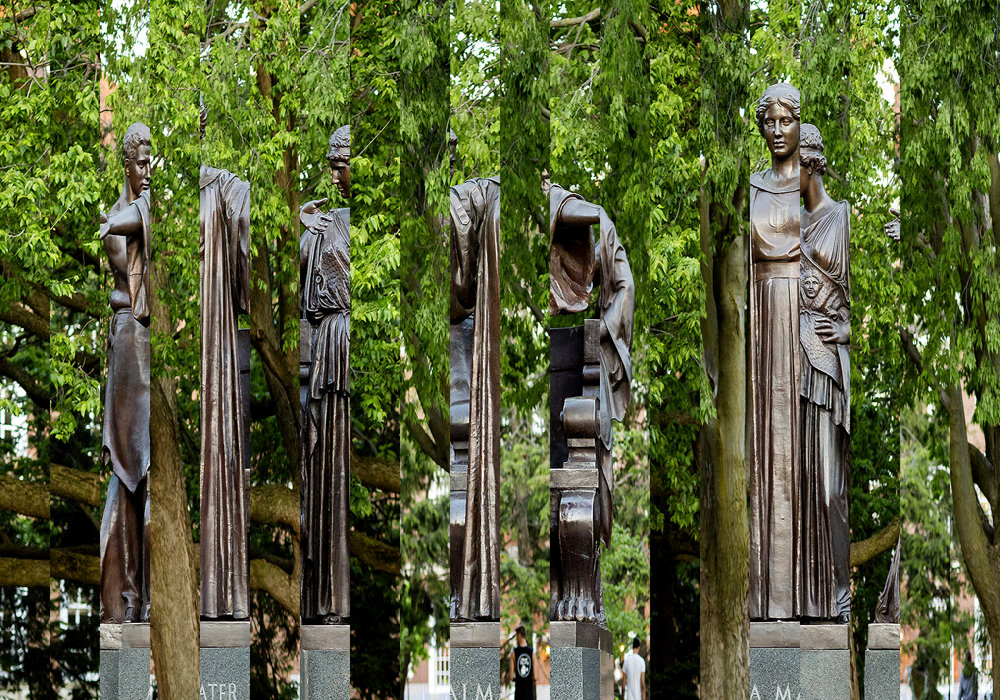

In [209]:
combineThePicturs("./shredded-images/simple_almastatue/*.png",'./combined_output/com_simple_almastatue.png')

In [210]:
#firstly, we put all the folder names in a list:
name_list = ['hard_almastatue','hard_building','hard_text','hard_texture','simple_almastatue','simple_larry-roberts']


#then, we canput the input path list:
inputPathList = []
for name in name_list:
    inputPathList.append("./shredded-images/" + name +"/*.png")

outputPathList = []
for name in name_list:
    outputPathList.append("./combined_output/com_" + name +".png")



<ipython-input-208-2ffbae4f166a>:9: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  imgs_comb = np.hstack( (np.asarray( i.resize(min_shape) ) for i in imgs ) )


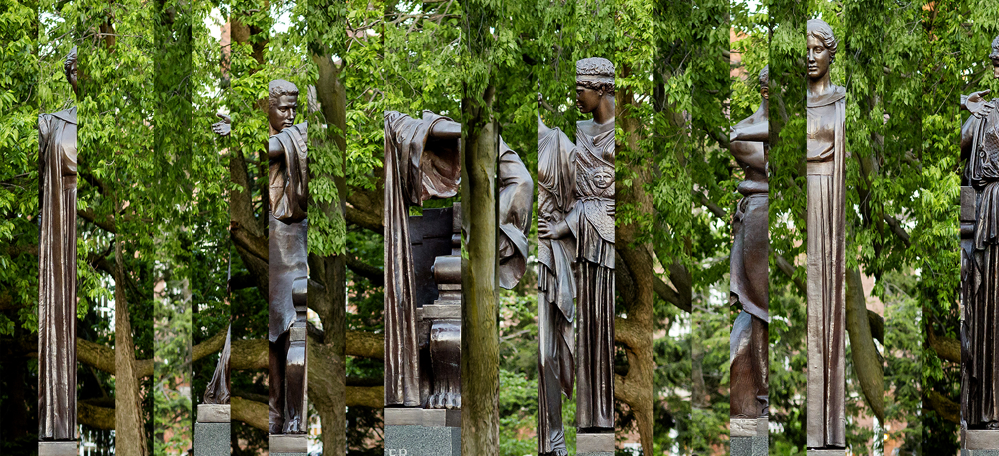

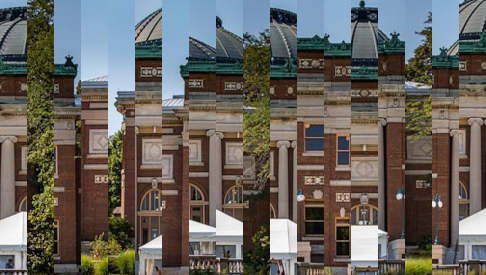

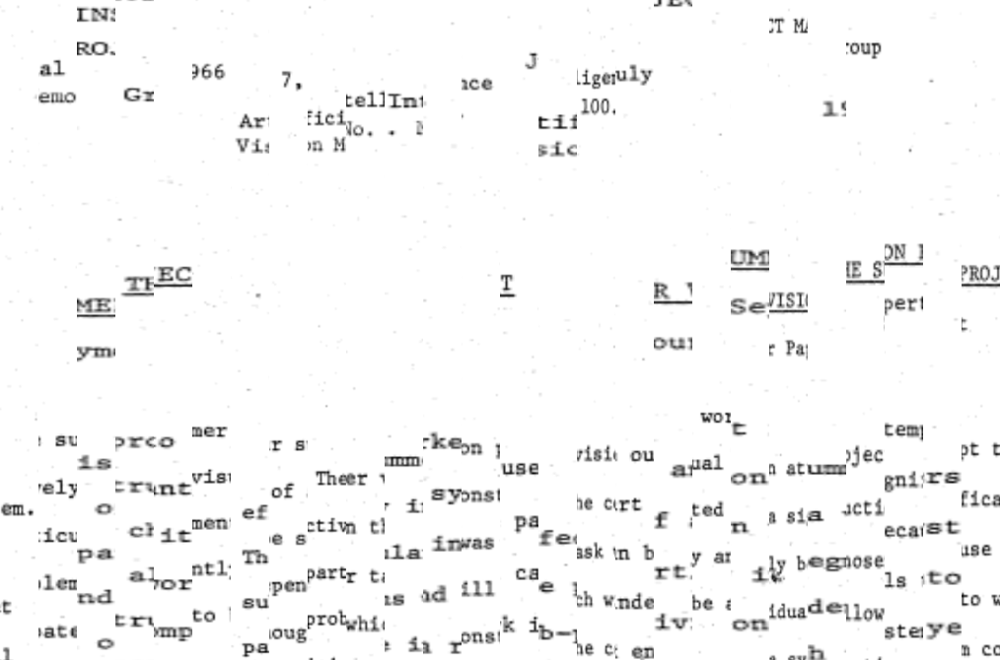

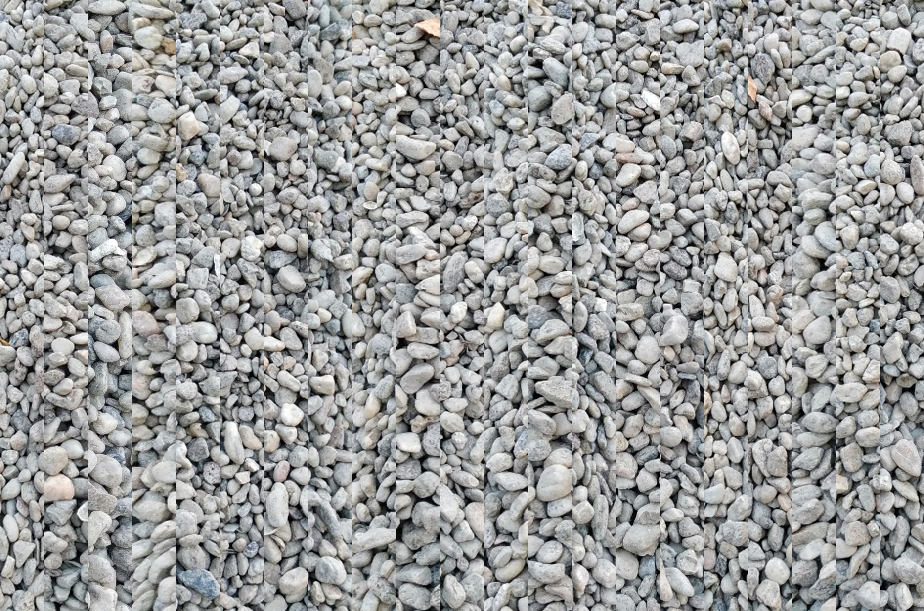

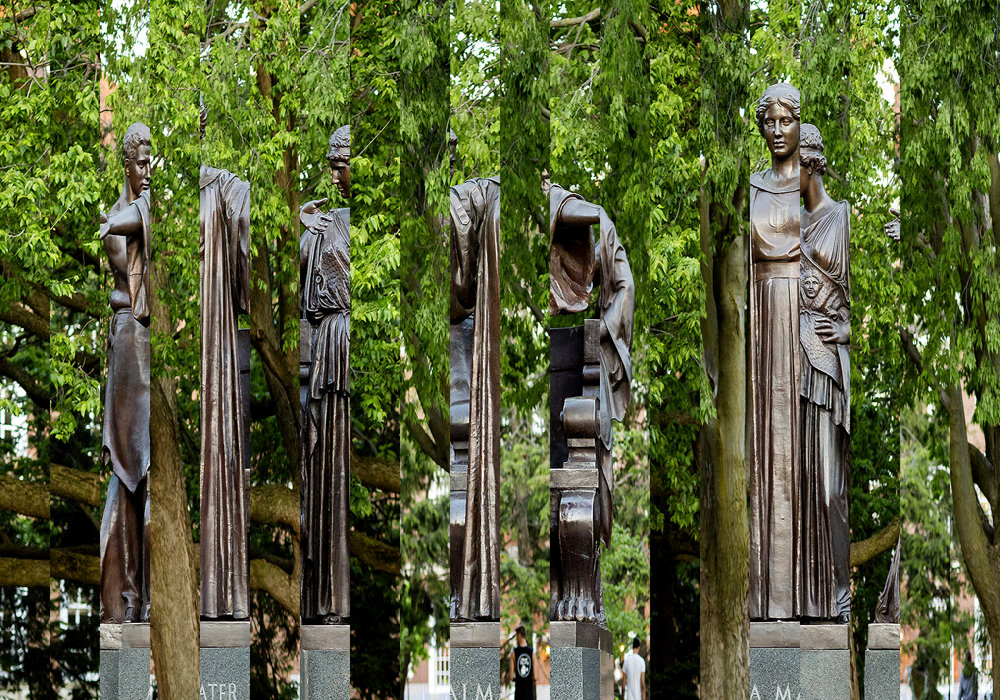

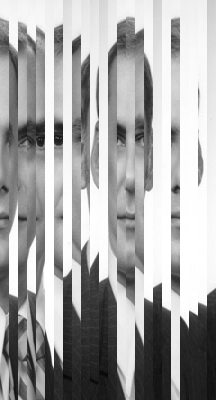

In [211]:
#start the loop

for i in range(len(name_list)):
    combineThePicturs(inputPathList[i],outputPathList[i])

In [425]:
#part2

def getFirstLastColumn(imgs):
    """
    construct the two list that store the pix of the first colums and last colums
    
    """
    firstColumn = []
    lastColumn = []
    for im in imgs:
        pix = im.load()
        first = []
        last = []
        w = im.size[0]
        h = im.size[1]
        for i in range(h):
            first.append(pix[0, i])
            last.append(pix[w-1, i])
        firstColumn.append(first)
        lastColumn.append(last)
    return firstColumn, lastColumn


In [150]:

def pixelDiff(pix1, pix2):
    """
    To compute the differences between two pixels
    """
    ans = 0
    for i in range(3):
        ans += abs(pix1[i] - pix2[i])**2
    return ans

In [151]:
def pixelListDiff(list1, list2):
    """
    To compute the sum of the differences between two list of pixels,
    hopefully it is the same size. 
    Like: pixelListDiff(lastColumn[0], firstColumn[1])
    """
    ans = 0;
    for i in range(len(list1)):
        ans += pixelDiff(list1[i], list2[i])
    return ans



In [442]:


def getOrderedListOfPicFiles(inputPath):
    """
    This fucntion will return the ordered order_listOfPicFiles
    
    We need to check the lastColum of of strip and the firstColum of another strip and computer their diff.
    
    """
    listOfPicFiles = glob.glob(inputPath)
    listOfPicFiles.sort()
    imgs = [ PIL.Image.open(i) for i in listOfPicFiles ]
    
    firstColumn, lastColumn = getFirstLastColumn(imgs)
    n = len(firstColumn)
    diff_array = np.zeros([n, n])
    heap = []
    for i in range(n):
        for j in range(n):
            diff = pixelListDiff(lastColumn[i],firstColumn[j])
            diff_array[i][j] = diff
            if i != j:
                heap.append((diff, i, j))

    heap.sort(key=lambda tup: tup[0])
    
    order = np.zeros([n]) #order[i] = j means the next of picture i is picture j
    usedJ = np.zeros([n]) #to check if the picture have already decided the pic before it. If yes, usedJ[i] = 1. If not, If yes, usedJ[i] = 0 
    index = np.zeros([n])
    
    for i in range(n):
        order[i] = -1
        index[i] = i
       
    count = 0
    for tup in heap:
        i = tup[1]
        j = tup[2]
        if i < n and order[i] == -1 and usedJ[j] == 0:
            order[tup[1]] = tup[2]
            usedJ[tup[2]] = 1
            count += 1
            if count == n-1:
                break
          
    order = order.astype(np.int)
    index = index.astype(np.int)
#     print(order)
#     print(usedJ)
#     print(index)
    
    # now make the new orders:
    # first the left most picture: 
    first = -1
    for i in range(n):
        if usedJ[i] == 0:
            first = i
            break
#     print(first)        
    order_listOfPicFiles = []
    for i in range(n):
        order_listOfPicFiles.append(listOfPicFiles[first])
        first = order[first]
    # print(listOfPicFiles)
    return order_listOfPicFiles

In [443]:
def combineSimpleOrderedPictures(inputPath, outputPath):
    order_listOfPicFiles = getOrderedListOfPicFiles(inputPath)
    order_imgs = [ PIL.Image.open(i) for i in order_listOfPicFiles ]
    min_shape = sorted( [(np.sum(i.size), i.size ) for i in order_imgs])[0][1]
    imgs_comb = np.hstack( (np.asarray( i.resize(min_shape) ) for i in order_imgs ) )
    # save that result picture
    imgs_comb = PIL.Image.fromarray(imgs_comb)
    display(imgs_comb)
    imgs_comb.save( outputPath) #  './ordered_simple_almastatue.png'

[ 5  0  9 17 11  3 16  1 19 15 18  6 10  7 -1  4 12  2  8 14]
[1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 1. 1. 1. 1. 1. 1.]
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19]
13


<ipython-input-443-2f7dad5d494f>:5: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  imgs_comb = np.hstack( (np.asarray( i.resize(min_shape) ) for i in order_imgs ) )


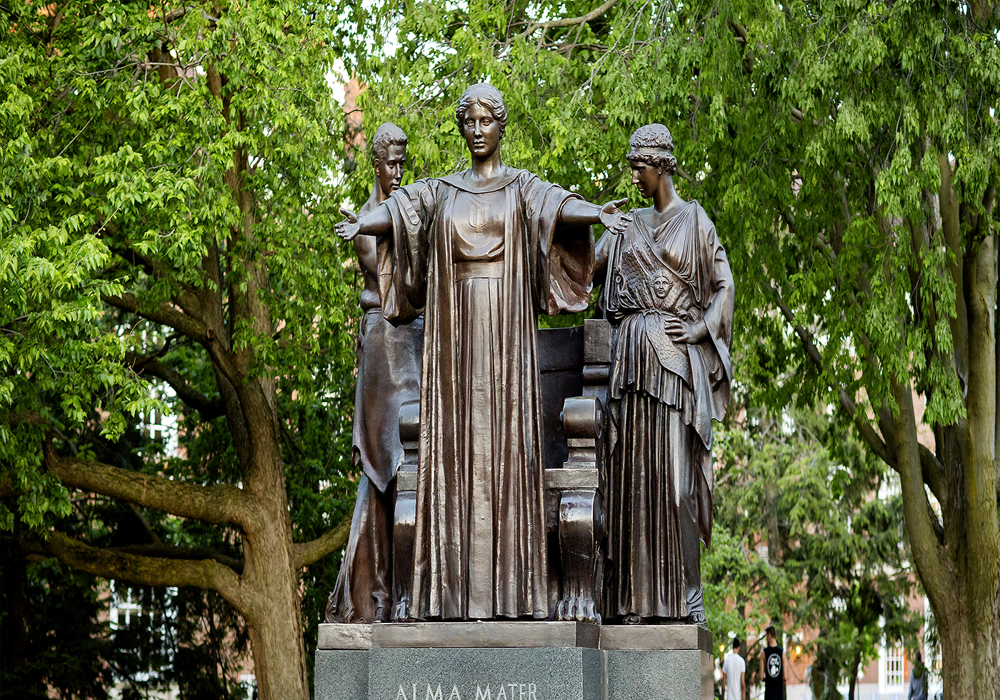

[ 2 16  4  1  3 -1 13 10 15 12  9  7  8 19  0  6 22 11 21 14  5 20 18 17]
[1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0.]
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23]
23


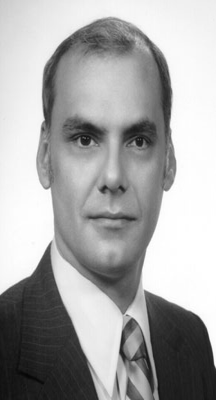

In [444]:
# Then we can start our functions:

#firstly, we put all the folder names in a list:
simple_name_list = ['simple_almastatue','simple_larry-roberts']


#then, we canput the input path list:
simple_inputPathList = []
for name in simple_name_list:
    simple_inputPathList.append("./shredded-images/" + name +"/*.png")

ordered_simple_outputPathList = []
for name in name_list:
    ordered_simple_outputPathList.append("./simple_ordered_combined_output/ordered" + name +".png")


for i in range(len(simple_name_list)):
    combineSimpleOrderedPictures(simple_inputPathList[i],ordered_simple_outputPathList[i])




In [182]:
#part3

In [8]:
def normalizedVec(list):
    list = np.asarray(list, dtype = np.float64)
    mean = np.mean(list)
    list -= mean
    norm = np.linalg.norm(list)
    normal_array = list/norm

    return normal_array

def calculateDiff1(vec1, vec2):
    """
    overlap the lower part of the longer one    
    """
    if len(vec1) > len(vec2):
        vec1 = vec1[-len(vec2):]
    if len(vec1) < len(vec2):
        vec2 = vec2[-len(vec1):]
    vec1 = normalizedVec(vec1)
    vec2 = normalizedVec(vec2)
    vec1 = vec1.flatten()
    vec2 = vec2.flatten()


    return 1- vec1 @ vec2

def calculateDiff2(vec1, vec2):
    """
    overlap the higher part of the longer one    
    """

    if len(vec1) > len(vec2):
        vec1 = vec1[:len(vec2)]
    if len(vec1) < len(vec2):
        vec2 = vec2[:len(vec1)]

    vec1 = normalizedVec(vec1)
    vec2 = normalizedVec(vec2)
    vec1 = vec1.flatten()
    vec2 = vec2.flatten()

    return 1- vec1 @ vec2


def slide(vec1, vec2):
    """
    we suppose the initial state it is bottom of the strips are at the same level
    s is positive means left one goes up
    s is negative means left one goes down
    """
    len1 = len(vec1)
    len2 = len(vec2)

    mindiff = calculateDiff1(vec1, vec2)
    bestslide = 0
    
    
    if len1 >= len2:
        sliderange =int(len2 * 0.2)
        for s in range(sliderange):
            newvec1 = []
            newvec2 = []
            
            #situation1
            #make the left one go down and overlap the lower part of the longer one
            for i in range(len1 - s):#upper part the left one
                newvec1.append(vec1[i])
                
            diff = calculateDiff1(newvec1, vec2)
            if diff < mindiff:
                mindiff = diff
                bestslide = -s
                
            #situation2
            #make the left one go up and overlap the higher part of the longer one    
            for i in range(s, len1):#lower part of left one
                newvec2.append(vec1[i])
                
            diff = calculateDiff2(newvec2, vec2)
            if diff < mindiff:
                mindiff = diff
                bestslide = (len2 - (len1-s))


       
    if len1 < len2:
        sliderange =int(len1 * 0.2)
        for s in range(sliderange):
            newvec1 = []
            newvec2 = []
            
            #situation3
            #make the left one go up 
            for i in range(len2 - s): #upper part of right one, shorter one
                newvec1.append(vec2[i])
            diff = calculateDiff1(newvec1, vec1)
            if diff < mindiff:
                mindiff = diff
                bestslide = s


            #situation4
            #make the left one go down   
            for i in range(s, len2): #lower part of right one, shorter one 
                newvec2.append(vec2[i])
            diff = calculateDiff2(newvec2, vec1)
            if diff < mindiff:
                mindiff = diff
                bestslide = (len1 - (len2-s)) * -1


    return mindiff, bestslide 

            
            

In [9]:
def union(parent, a, b):
    roota = find(parent,a)
    rootb = find(parent,b)
    if roota == rootb:
        return False
    if roota < rootb:
        parent[roota] = rootb
        return True
    if rootb < roota:
        parent[rootb] = roota
        return True
        
def find(parent, a):
    if parent[a] != a:
        parent[a] = find(parent,parent[a])
    return parent[a]


def add_padding(pil_img, top, right, bottom, left, color):
    """
    black(0,0,0)
    """
    width, height = pil_img.size
    new_width = width + right + left
    new_height = height + top + bottom
    result = Image.new(pil_img.mode, (new_width, new_height), color)
    result.paste(pil_img, (left, top))
    return result


In [10]:
def combineHardOrderedPictures(inputPath, outputPath):
# inputPath = "./shredded-images/" + "hard_text" +"/*.png"
    listOfPicFiles = glob.glob(inputPath)
    listOfPicFiles.sort()
    imgs = [ PIL.Image.open(i) for i in listOfPicFiles ]

    #to compute the first column, last coloum and the height of each picture in orders
    firstColumn = []
    lastColumn = []
    picHeight = []
    for im in imgs:
        pix = im.load()
        first = []
        last = []
        w = im.size[0]
        h = im.size[1]
        picHeight.append(h)
        for i in range(h):
            first.append(pix[0, i])
            last.append(pix[w-1, i])        
        firstColumn.append(first)
        lastColumn.append(last)

    n = len(firstColumn)

    diff_array = np.zeros([n, n])
    heap = []
    for i in range(n):
        for j in range(n):
            if i != j:
                diff, s = slide(lastColumn[i],firstColumn[j])
                diff_array[i][j] = diff
                heap.append((diff, i, j, s))

    heap.sort(key=lambda tup: tup[0])
    
    

    order = np.zeros([n]) #order[i] = j means the next of picture i is picture j
    usedJ = np.zeros([n]) #to check if the picture have already decided the pic before it. If yes, usedJ[i] = 1. If not, If yes, usedJ[i] = 0 
    usedI = np.zeros([n]) #to check if the picture have already decided the pic after it.
    parent = np.zeros([n]) #used for union find
    slide_amount = np.zeros([n]) #to store the sliding amount of this strip
    # situation = np.zeros(n)
    for i in range(n):
        order[i] = -1
        parent[i] = i

    parent = parent.astype(np.int)

    count = 0
    for tup in heap:
        i = tup[1]
        j = tup[2]        
        if usedJ[j] == 0 and usedI[i] == 0:
            if union(parent, i, j):
                order[i] = j
    #             situation[i] = tup[4]
                slide_amount[i] = tup[3]
                usedJ[j] = 1
                usedI[i] = 1
                count += 1
                if count == n-1:
                    break


    order = order.astype(np.int)



    # now make the new orders:
    # first the left most picture: 
    first = -1
    for i in range(n):
        if usedJ[i] == 0:
            first = i
            break

    order_listOfPicFiles = []
    order_slideamount = []
    pic_order = []
    # order_situation = []

    for i in range(n):
        order_listOfPicFiles.append(listOfPicFiles[first])
        pic_order.append(first)
        order_slideamount.append(slide_amount[first])
    #     order_situation.append(situation[first])
        first = order[first]

    # print(order_listOfPicFiles)
    # print(order_slideamount)
    # print(order_situation)
    
    bottom_index_list = np.zeros([n])
    top_index_list = np.zeros([n])
    cur = 0
    for i in range(1,len(order_slideamount)):
        bottom_index_list[i] = bottom_index_list[i-1] - order_slideamount[i-1]
    bottom_index_list = bottom_index_list.astype(np.int)

#     print(bottom_index_list)




    test_height_sample = []
    for i in range(len(bottom_index_list)):
        top_index_list[i] = bottom_index_list[i] + picHeight[pic_order[i]] 
        test_height_sample.append(picHeight[pic_order[i]] )

    print(test_height_sample)
    # print(order_situation)
    #     print(order_listOfPicFiles)


    toppest = np.max(top_index_list)

    bottomest = np.min(bottom_index_list)

    top_padding = np.zeros([n])
    bottom_padding = np.zeros([n])



    for i in range(len(bottom_index_list)):
        top_padding[i] = toppest - top_index_list[i]
        bottom_padding[i] = bottom_index_list[i] - bottomest

    top_padding = top_padding.astype(np.int)
    bottom_padding = bottom_padding.astype(np.int)



    order_imgs = []
    # print(n)
    # # print(listOfPicFiles)
    # print(order_listOfPicFiles)

    for i in range(len(order_listOfPicFiles)):
        newimg = add_padding(PIL.Image.open(order_listOfPicFiles[i]),top_padding[i],0,bottom_padding[i], 0, (0,0,0))
    #     print(newimg.im.size[1])
        order_imgs.append(newimg)
#     print(order_situation)
    min_shape = sorted( [(np.sum(i.size), i.size ) for i in order_imgs])[0][1]
    imgs_comb = np.hstack( (np.asarray( i.resize(min_shape) ) for i in order_imgs ) )
    # save that result picture
    imgs_comb = PIL.Image.fromarray(imgs_comb)
    display(imgs_comb)
    imgs_comb.save(outputPath) #  './ordered_simple_almastatue.png









[850, 865, 844, 882, 834, 949, 895, 910, 895, 899, 864, 798, 971, 934, 801, 851, 818, 808, 832, 819, 932, 796, 806, 913, 868, 854]


<ipython-input-10-5822875df175>:146: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  imgs_comb = np.hstack( (np.asarray( i.resize(min_shape) ) for i in order_imgs ) )


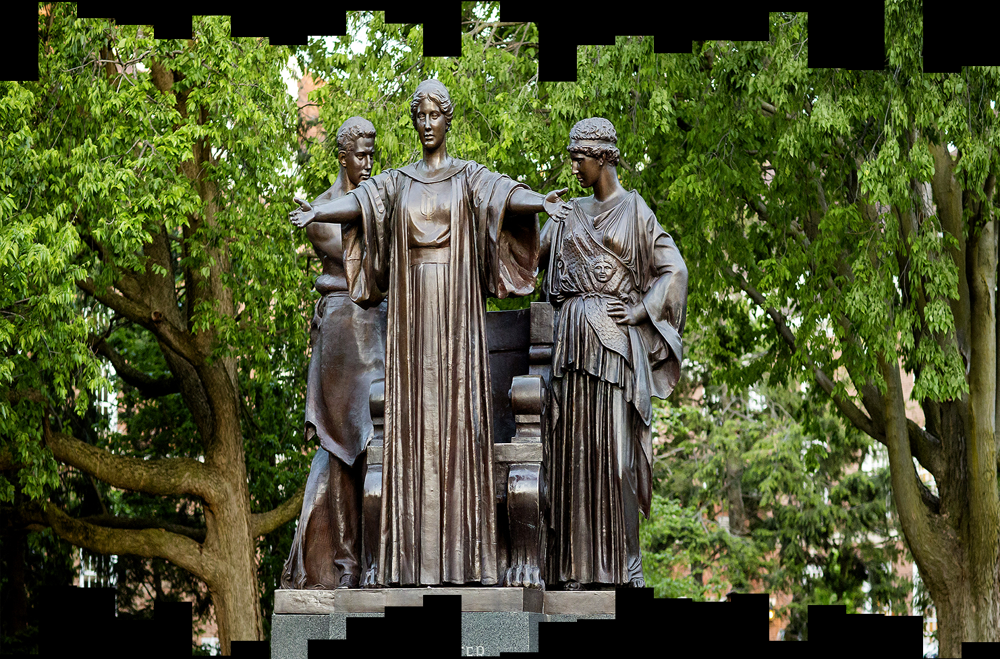

[324, 298, 297, 268, 312, 283, 296, 316, 298, 307, 333, 334, 298, 289, 298, 304, 305, 275]


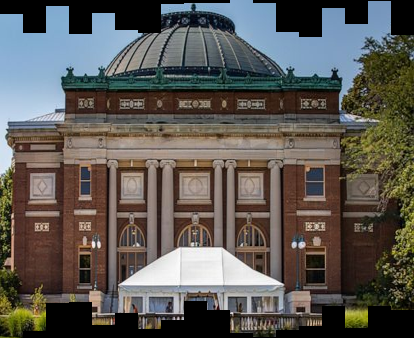

[785, 739, 755, 735, 761, 722, 725, 748, 788, 668, 724, 786, 692, 736, 698, 704, 742, 670, 715, 748, 759, 761, 752, 689, 696, 712]


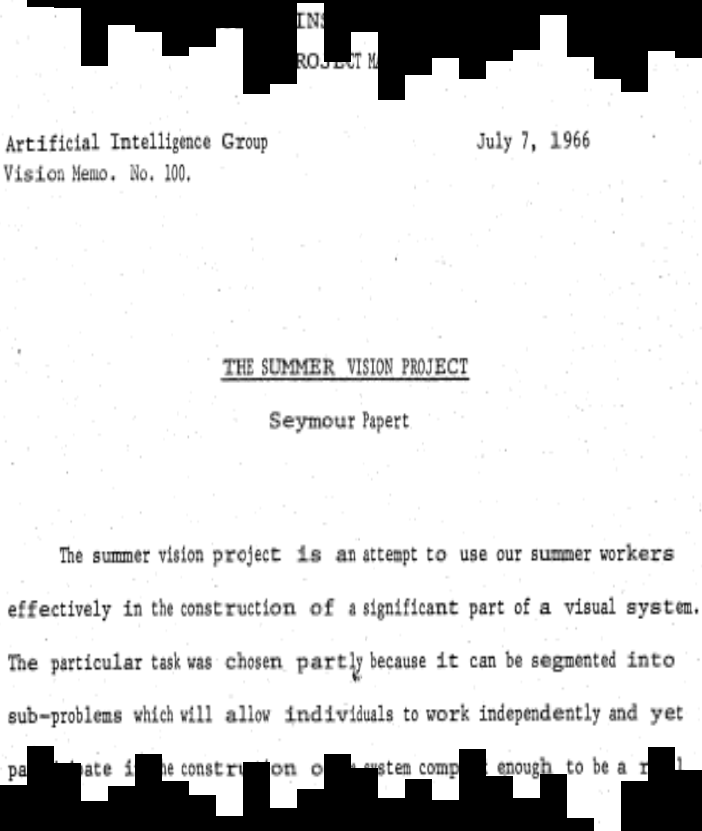

[691, 683, 641, 650, 765, 649, 663, 664, 677, 666, 660, 724, 693, 724, 676, 615, 731, 690, 666, 611, 717]


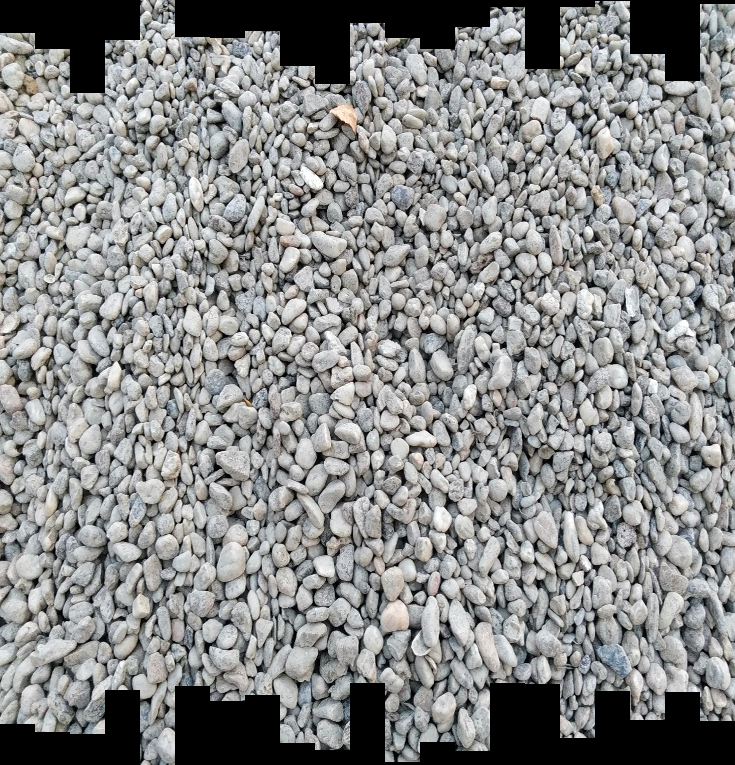

In [12]:
# Then we can start our functions:

#firstly, we put all the folder names in a list:
hard_name_list = ['hard_almastatue','hard_building','hard_text','hard_texture']
# hard_name_list = ['hard_building']


#then, we canput the input path list:
hard_inputPathList = []
for name in hard_name_list:
    hard_inputPathList.append("./shredded-images/" + name +"/*.png")

ordered_hard_outputPathList = []
for name in hard_name_list:
    ordered_hard_outputPathList.append("./hard_ordered_combined_output/ordered" + name +".png")


for i in range(len(hard_name_list)):
    combineHardOrderedPictures(hard_inputPathList[i],ordered_hard_outputPathList[i])

